In [1]:
!pip install skforecast


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 670.5/670.5 kB 12.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 362.8/362.8 kB 21.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.2/233.2 kB 12.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 5.0 MB/s eta 0:00:00


In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
#Import all the library

import pandas as pd
import numpy as np
import folium
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import StandardScaler
from skforecast.ForecasterAutoreg import ForecasterAutoreg
from lightgbm import LGBMRegressor

In [60]:
#Import the Dataset
df = pd.read_csv('Crime_Data_from_2020_to_Present.csv')
df.head(5)

,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,...,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON
0,190326475,03/01/2020 12:00:00 AM,03/01/2020 12:00:00 AM,2130,7,Wilshire,784,1,510,VEHICLE - STOLEN,...,AA,Adult Arrest,510.0,998.0,NaN,NaN,1900 S LONGWOOD AV,NaN,34.0375,-118.3506
1,200106753,02/09/2020 12:00:00 AM,02/08/2020 12:00:00 AM,1800,1,Central,182,1,330,BURGLARY FROM VEHICLE,...,IC,Invest Cont,330.0,998.0,NaN,NaN,1000 S FLOWER ST,NaN,34.0444,-118.2628
2,200320258,11/11/2020 12:00:00 AM,11/04/2020 12:00:00 AM,1700,3,Southwest,356,1,480,BIKE - STOLEN,...,IC,Invest Cont,480.0,NaN,NaN,NaN,1400 W 37TH ST,NaN,34.0210,-118.3002
3,200907217,05/10/2023 12:00:00 AM,03/10/2020 12:00:00 AM,2037,9,Van Nuys,964,1,343,SHOPLIFTING-GRAND THEFT ($950.01 & OVER),...,IC,Invest Cont,343.0,NaN,NaN,NaN,14000 RIVERSIDE DR,NaN,34.1576,-118.4387
4,220614831,08/18/2022 12:00:00 AM,08/17/2020 12:00:00 AM,1200,6,Hollywood,666,2,354,THEFT OF IDENTITY,...,IC,Invest Cont,354.0,NaN,NaN,NaN,1900 TRANSIENT,NaN,34.0944,-118.3277


In [61]:
df.tail(5)

,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,...,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON
955334,241604405,01/14/2024 12:00:00 AM,01/13/2024 12:00:00 AM,720,16,Foothill,1673,1,230,"ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT",...,IC,Invest Cont,230.0,NaN,NaN,NaN,8700 LANKERSHIM BL,NaN,34.2271,-118.3878
955335,242106032,02/20/2024 12:00:00 AM,02/17/2024 12:00:00 AM,2330,21,Topanga,2103,1,420,THEFT FROM MOTOR VEHICLE - PETTY ($950 & UNDER),...,IC,Invest Cont,420.0,NaN,NaN,NaN,22700 NAPA ST,NaN,34.2260,-118.6214
955336,242004546,01/16/2024 12:00:00 AM,01/16/2024 12:00:00 AM,1510,20,Olympic,2013,2,624,BATTERY - SIMPLE ASSAULT,...,IC,Invest Cont,624.0,NaN,NaN,NaN,HOBART BL,3RD ST,34.0690,-118.3054
955337,240104953,01/15/2024 12:00:00 AM,01/15/2024 12:00:00 AM,100,1,Central,101,2,745,VANDALISM - MISDEAMEANOR ($399 OR UNDER),...,IC,Invest Cont,745.0,NaN,NaN,NaN,1300 W SUNSET BL,NaN,34.0685,-118.2460
955338,240309674,04/24/2024 12:00:00 AM,04/24/2024 12:00:00 AM,1500,3,Southwest,358,1,230,"ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT",...,IC,Invest Cont,230.0,NaN,NaN,NaN,FLOWER ST,JEFFERSON BL,34.0215,-118.2868


In [62]:
# Get basic information about the dataset
data_info = df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 955339 entries, 0 to 955338
Data columns (total 28 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   DR_NO           955339 non-null  int64  
 1   Date Rptd       955339 non-null  object 
 2   DATE OCC        955339 non-null  object 
 3   TIME OCC        955339 non-null  int64  
 4   AREA            955339 non-null  int64  
 5   AREA NAME       955339 non-null  object 
 6   Rpt Dist No     955339 non-null  int64  
 7   Part 1-2        955339 non-null  int64  
 8   Crm Cd          955339 non-null  int64  
 9   Crm Cd Desc     955339 non-null  object 
 10  Mocodes         818664 non-null  object 
 11  Vict Age        955339 non-null  int64  
 12  Vict Sex        825294 non-null  object 
 13  Vict Descent    825284 non-null  object 
 14  Premis Cd       955327 non-null  float64
 15  Premis Desc     954770 non-null  object 
 16  Weapon Used Cd  325019 non-null  float64
 17  Weapon Des

In [63]:
# Check for missing values in each column
missing_values = df.isnull().sum()

In [64]:
# Convert the 'DATE OCC' and 'Date Rptd' columns to datetime format
df['DATE OCC'] = pd.to_datetime(df['DATE OCC'], format='%m/%d/%Y %I:%M:%S %p', errors='coerce')
df['Date Rptd'] = pd.to_datetime(df['Date Rptd'], format='%m/%d/%Y %I:%M:%S %p', errors='coerce')

# Check for any issues in the conversion (e.g., if there are missing or unparsed values)
print(df[['DATE OCC', 'Date Rptd']].head())  # Check the first few rows of the date columns
print(df[['DATE OCC', 'Date Rptd']].isnull().sum())  # Check if any rows were not parsed


    DATE OCC  Date Rptd
0 2020-03-01 2020-03-01
1 2020-02-08 2020-02-09
2 2020-11-04 2020-11-11
3 2020-03-10 2023-05-10
4 2020-08-17 2022-08-18
DATE OCC     0
Date Rptd    0
dtype: int64


In [65]:
# Get basic statistical summary for numerical columns
data_stats = df.describe()

In [66]:
data_info, missing_values, data_stats

(None,
 DR_NO                  0
 Date Rptd              0
 DATE OCC               0
 TIME OCC               0
 AREA                   0
 AREA NAME              0
 Rpt Dist No            0
 Part 1-2               0
 Crm Cd                 0
 Crm Cd Desc            0
 Mocodes           136675
 Vict Age               0
 Vict Sex          130045
 Vict Descent      130055
 Premis Cd             12
 Premis Desc          569
 Weapon Used Cd    630320
 Weapon Desc       630320
 Status                 1
 Status Desc            0
 Crm Cd 1              11
 Crm Cd 2          886873
 Crm Cd 3          953045
 Crm Cd 4          955275
 LOCATION               0
 Cross Street      806439
 LAT                    0
 LON                    0
 dtype: int64,
               DR_NO                      Date Rptd  \
 count  9.553390e+05                         955339   
 mean   2.191355e+08  2022-04-11 17:54:26.347547648   
 min    8.170000e+02            2020-01-01 00:00:00   
 25%    2.105125e+08          

In [67]:
!pip install folium seaborn

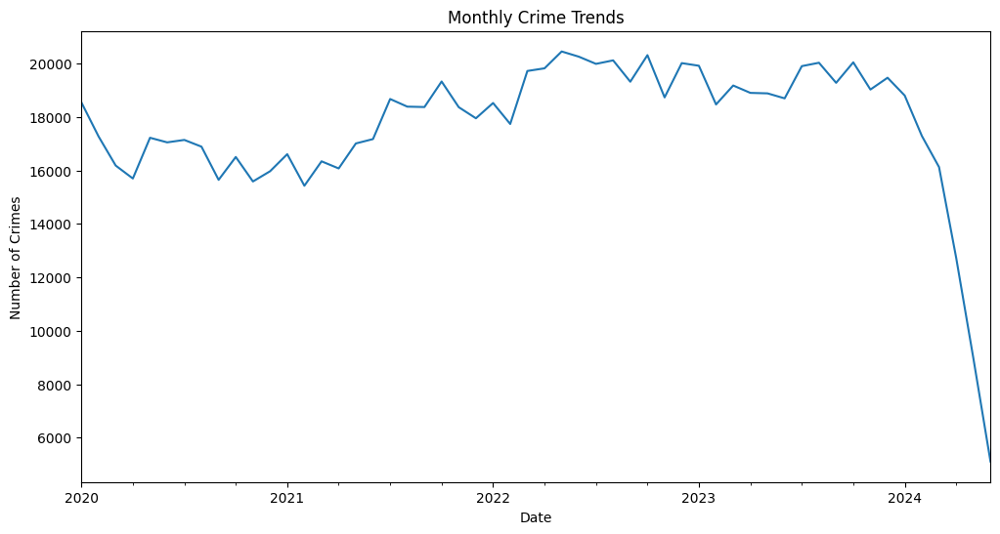

In [68]:
#Trend Analysis

df['Year'] = df['DATE OCC'].dt.year
monthly_crime = df.resample('M', on='DATE OCC').size()
plt.figure(figsize=(12, 6))
monthly_crime.plot()
plt.title('Monthly Crime Trends')
plt.xlabel('Date')
plt.ylabel('Number of Crimes')
plt.show()


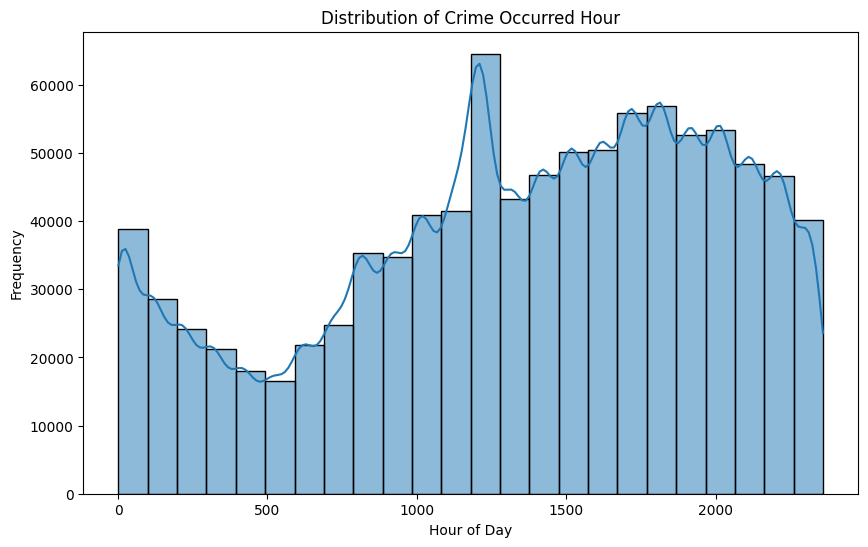

In [69]:
#Distribution of Crime Occurred Hour using Histogram

plt.figure(figsize=(10, 6))
sns.histplot(df['TIME OCC'], bins=24, kde=True)
plt.title('Distribution of Crime Occurred Hour')
plt.xlabel('Hour of Day')
plt.ylabel('Frequency')
plt.show()


In [70]:
import folium
from folium.plugins import HeatMap

data_filtered = df.dropna(subset=['LAT', 'LON'])

# Create a map centered around the average coordinates
crime_map = folium.Map(location=[data_filtered['LAT'].mean(),
                                 data_filtered['LON'].mean()],
                                 zoom_start=12)

# Prepare data for the heatmap (latitude and longitude pairs)
heat_data = [[row['LAT'], row['LON']] for index, row in data_filtered.iterrows()]

# Add heatmap to the map
HeatMap(heat_data).add_to(crime_map)

# Display map
crime_map


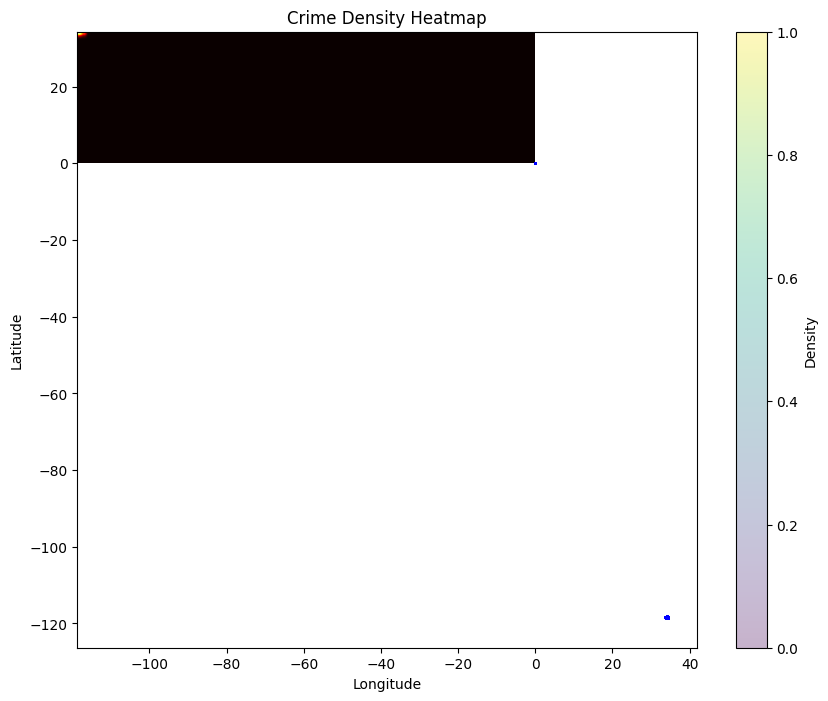

In [71]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.neighbors import KernelDensity

# Assume 'data_filtered' contains the latitude and longitude after cleaning NaN values
coords = data_filtered[['LAT', 'LON']].values

# Convert degrees to radians (important for geographical coordinates)
coords_radians = np.radians(coords)

# Fit the KDE model with a suitable bandwidth (you can tune bandwidth for different results)
kde = KernelDensity(bandwidth=0.01, metric='haversine')
kde.fit(coords_radians)

# Define the range for grid (latitude and longitude bounds)
lat_min, lat_max = data_filtered['LAT'].min(), data_filtered['LAT'].max()
lon_min, lon_max = data_filtered['LON'].min(), data_filtered['LON'].max()

# Create a grid of points where we will estimate the density
lat_grid, lon_grid = np.mgrid[lat_min:lat_max:100j, lon_min:lon_max:100j]
grid = np.vstack([lat_grid.ravel(), lon_grid.ravel()]).T
grid_radians = np.radians(grid)

# Get density estimates for the grid points
log_density = kde.score_samples(grid_radians)
density = np.exp(log_density).reshape(lat_grid.shape)

# Plot the result using Matplotlib
plt.figure(figsize=(10, 8))

# Plot density heatmap
plt.imshow(density, extent=(lon_min, lon_max, lat_min, lat_max), origin='lower', cmap='hot', aspect='auto')

# Add scatter of the actual crime points (for better visualization)
plt.scatter(data_filtered['LAT'], data_filtered['LON'], s=1, color='blue', alpha=0.3)

plt.title('Crime Density Heatmap')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.colorbar(label='Density')

plt.show()


In [72]:
# Check for issues in conversion
print(df[['DATE OCC', 'Date Rptd']].isnull().sum())

# Ensure 'TIME OCC' is numeric, filter out non-numeric values, and convert to int
df['TIME OCC'] = pd.to_numeric(df['TIME OCC'], errors='coerce')  # Convert to numeric
df = df[df['TIME OCC'].notnull()]  # Filter out rows with NaN in 'TIME OCC'

df['Hour'] = (df['TIME OCC'] // 100).astype(int)  # Convert TIME OCC to hour of day



DATE OCC     0
Date Rptd    0
dtype: int64


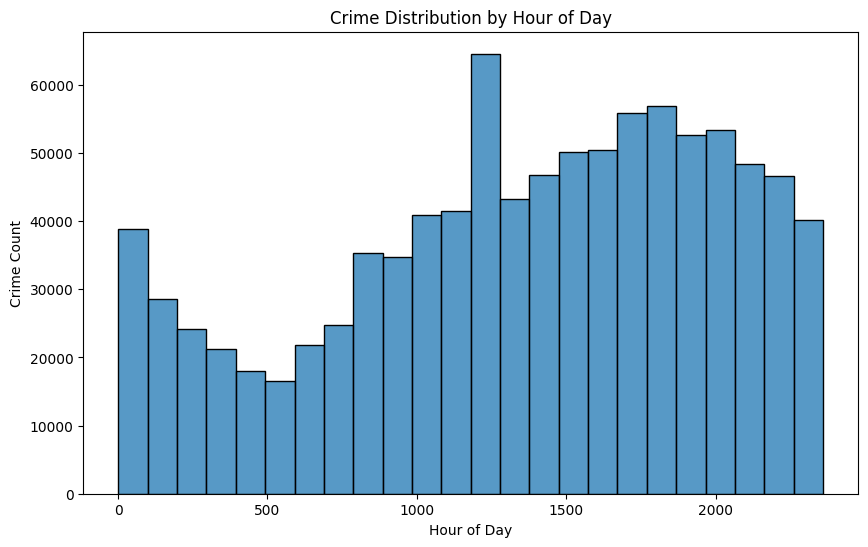

In [73]:
# Bivariate Analysis (Relationships Between Features)
# Example: Plotting crime frequency by hour of the day
plt.figure(figsize=(10, 6))
sns.histplot(df['TIME OCC'], bins=24, kde=False)
plt.title('Crime Distribution by Hour of Day')
plt.xlabel('Hour of Day')
plt.ylabel('Crime Count')
plt.show()


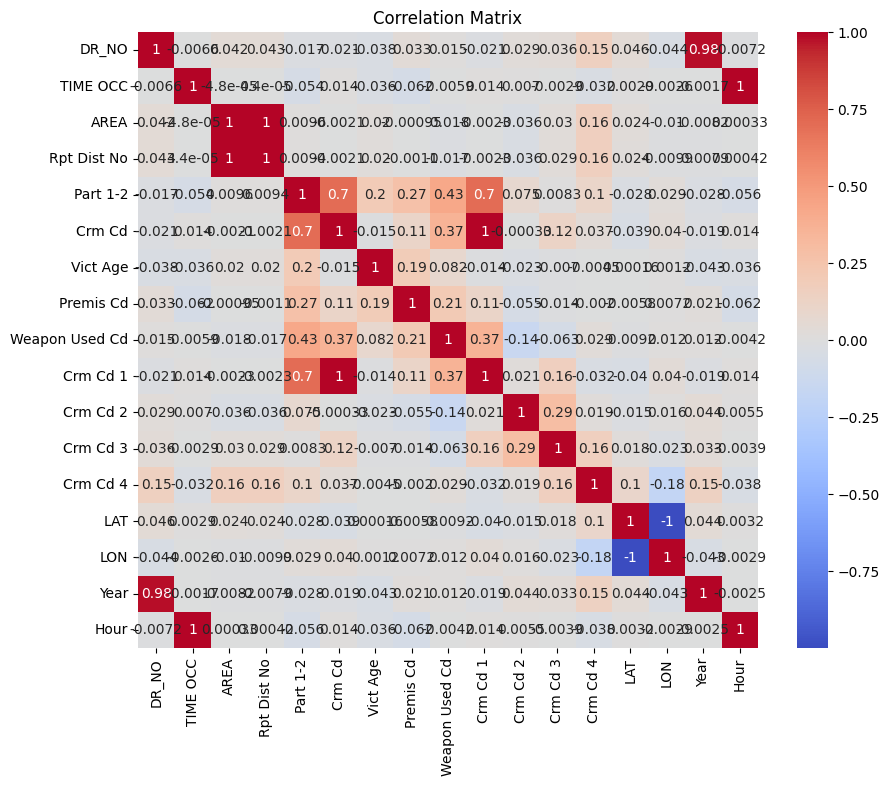

In [74]:
# Calculate the correlation matrix
numeric_df = df.select_dtypes(include=['number'])  # Select only numeric columns
corr_matrix = numeric_df.corr()  # Compute the correlation matrix

# Plot the correlation matrix heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

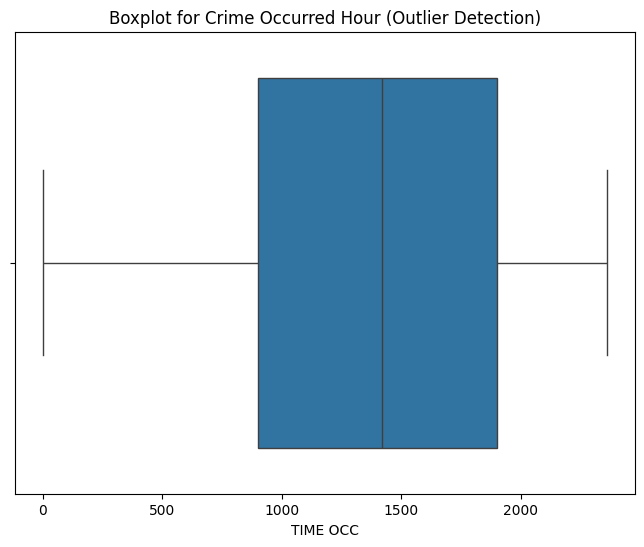

In [75]:
# Boxplot to Detect Outliers (Example for Crime Occurred Time)

plt.figure(figsize=(8, 6))
sns.boxplot(data=df, x='TIME OCC')
plt.title('Boxplot for Crime Occurred Hour (Outlier Detection)')
plt.show()


# **The top 10 crimes with reports**

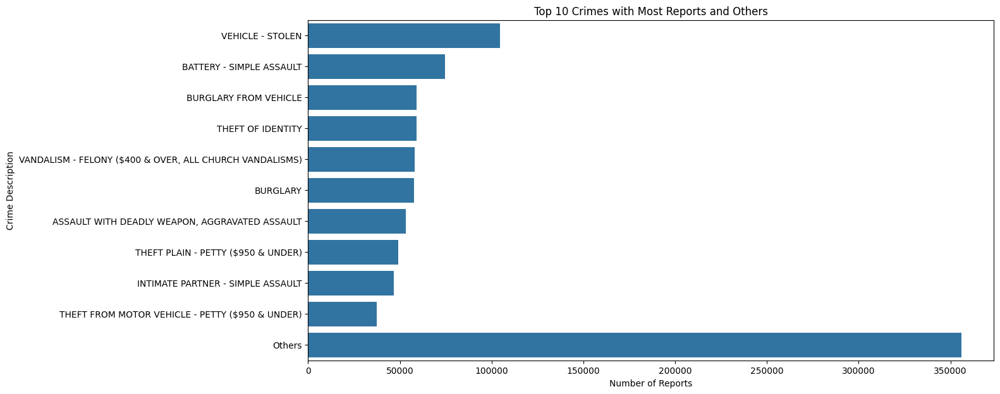

In [76]:

top_10_crimes = df['Crm Cd Desc'].value_counts().nlargest(10)

# Create a new column for plotting
df['Crm Cd Desc Plot'] = df['Crm Cd Desc'].apply(lambda x: x if x in top_10_crimes.index else 'Others')

# Ensure 'Others' appears at the end
df['Crm Cd Desc Plot'] = pd.Categorical(df['Crm Cd Desc Plot'], categories=list(top_10_crimes.index) + ['Others'], ordered=True)

# Plot the data
plt.figure(figsize=(14, 7))
sns.countplot(y='Crm Cd Desc Plot', data=df, order=list(top_10_crimes.index) + ['Others'])
plt.title('Top 10 Crimes with Most Reports and Others')
plt.xlabel('Number of Reports')
plt.ylabel('Crime Description')
plt.show()

# **Prediction for the next year**

In [77]:


# Create a pivot table with the sum of each Crime Cd by Area by date
pivot_df = df.pivot_table(index='DATE OCC', columns=['AREA NAME', 'Crm Cd'], values='DR_NO', aggfunc='count', fill_value=0)

pivot_df = pivot_df.asfreq('D', method = 'bfill') # Fill missing values with the previous value


In [78]:
# Display the first few rows of the pivot table
pivot_df.head(5)

AREA NAME  77th Street                                      ... Wilshire      \
Crm Cd             110 113 121 122 210 220 230 231 235 236  ...      932 933   
DATE OCC                                                    ...                
2020-01-01           0   0   2   0   4   1   4   0   0   3  ...        0   0   
2020-01-02           0   0   0   0   4   0   6   0   0   0  ...        0   0   
2020-01-03           0   0   0   0   3   0   6   0   0   0  ...        0   0   
2020-01-04           0   0   1   0   1   0   1   0   0   0  ...        0   0   
2020-01-05           0   0   0   0   2   2   2   0   0   0  ...        0   0   

AREA NAME                                   
Crm Cd     940 943 944 946 949 950 951 956  
DATE OCC                                    
2020-01-01   0   0   0   2   0   0   0   2  
2020-01-02   0   0   0   0   0   0   0   1  
2020-01-03   0   0   0   0   0   0   0   0  
2020-01-04   0   0   0   0   0   0   0   0  
2020-01-05   0   0   0   0   0   0   0   0  

[5 rows x 2389 columns]

In [79]:
#Now Re-arranege the pivot_df by month

# Resample pivot_df by month and sum the columns
monthly_crime_sum = pivot_df.resample('M').sum()
monthly_crime_sum.asfreq('M')

# Display the first few rows of the resampled DataFrame
monthly_crime_sum.head(5)

AREA NAME  77th Street                                       ... Wilshire      \
Crm Cd             110 113 121 122 210 220  230 231 235 236  ...      932 933   
DATE OCC                                                     ...                
2020-01-31           5   0   9   0  75  11  102   0   0  20  ...        0   0   
2020-02-29           1   0   5   4  92  12   85   2   0  31  ...        0   0   
2020-03-31           2   0   7   1  67   6   86   1   1  32  ...        1   0   
2020-04-30           5   0   5   0  48   8  109   3   2  37  ...        0   0   
2020-05-31           2   0   3   0  52   8  152   1   3  33  ...        0   0   

AREA NAME                                   
Crm Cd     940 943 944 946 949 950 951 956  
DATE OCC                                    
2020-01-31   2   0   0   9   0   0   1   9  
2020-02-29   2   0   0  12   0   1   0  10  
2020-03-31   1   0   0   7   0   0   0   6  
2020-04-30   0   0   0   5   0   0   0  10  
2020-05-31   1   0   0  11   0   1   0   8  

[5 rows x 2389 columns]

# **Model Creation**





In [80]:
forecaster = ForecasterAutoreg(
    regressor=LGBMRegressor(random_state=123,
                            n_jobs=-1,
                            n_estimators=100,
                            verbose=-1),
    lags=9  # Use the last 11 months of data
)

In [81]:
#Create Dictonary to store Prediction

predictions = pd.DataFrame()


In [82]:
for area in monthly_crime_sum.columns.levels[0]:
    for crime_type in monthly_crime_sum[area].columns:
        y = monthly_crime_sum[area][crime_type] #Training the data
        y_train = y[:-1]  # Use all data except the last month for training
        # Now, Fit the Forecaster and Make Predictions
        forecaster.fit(y=y_train)
        pred = forecaster.predict(steps=9)

        for i in pred.index:
            predictions = pd.concat([
                predictions,
                pd.DataFrame({
                    'Date': i,
                    'Area': area,
                    'Crime_Type': crime_type,
                    'Prediction': pred[i].astype(int)
                }, index=[i])
            ])

# **Prediction**


In [83]:
#Prediction for the model
predictions.head(20)


,Date,Area,Crime_Type,Prediction
2024-06-30,2024-06-30,77th Street,110,3
2024-07-31,2024-07-31,77th Street,110,5
2024-08-31,2024-08-31,77th Street,110,5
2024-09-30,2024-09-30,77th Street,110,4
2024-10-31,2024-10-31,77th Street,110,2
2024-11-30,2024-11-30,77th Street,110,3
2024-12-31,2024-12-31,77th Street,110,5
2025-01-31,2025-01-31,77th Street,110,5
2025-02-28,2025-02-28,77th Street,110,4
2024-06-30,2024-06-30,77th Street,113,0


In [84]:
predictions.tail(20)

,Date,Area,Crime_Type,Prediction
2025-01-31,2025-01-31,Wilshire,950,0
2025-02-28,2025-02-28,Wilshire,950,0
2024-06-30,2024-06-30,Wilshire,951,0
2024-07-31,2024-07-31,Wilshire,951,0
2024-08-31,2024-08-31,Wilshire,951,0
2024-09-30,2024-09-30,Wilshire,951,0
2024-10-31,2024-10-31,Wilshire,951,0
2024-11-30,2024-11-30,Wilshire,951,0
2024-12-31,2024-12-31,Wilshire,951,0
2025-01-31,2025-01-31,Wilshire,951,0


# **Predictions by Area**

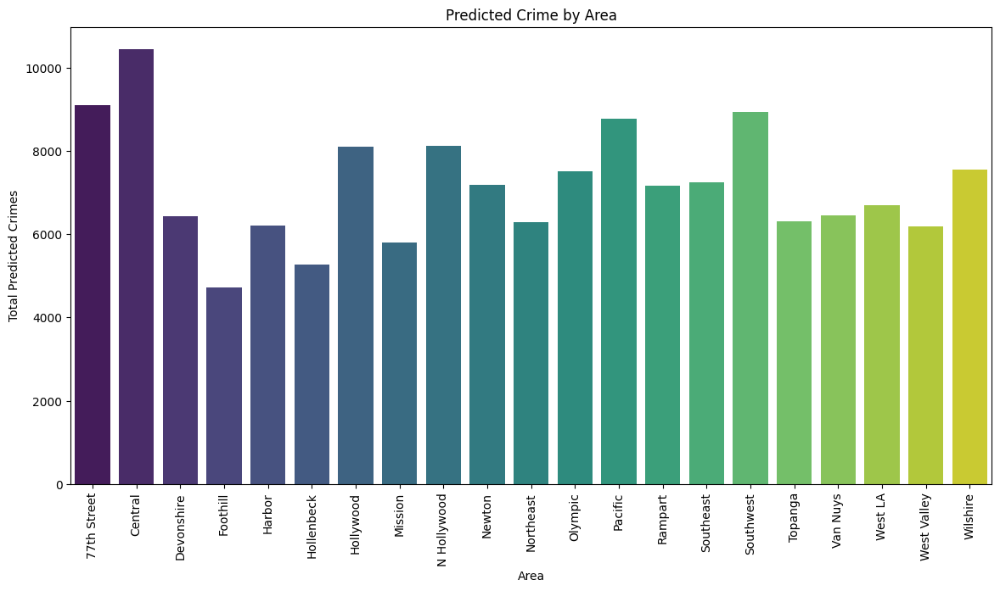

In [86]:


# Group the predictions by area and sum the predictions
predictions_by_area = predictions.groupby('Area')['Prediction'].sum().reset_index()

# Plot
plt.figure(figsize=(14, 7))
sns.barplot(x='Area', y='Prediction', data=predictions_by_area, palette='viridis')
plt.title('Predicted Crime by Area')
plt.xlabel('Area')
plt.ylabel('Total Predicted Crimes')
plt.xticks(rotation=90)
plt.show()

# **Predictions by month**

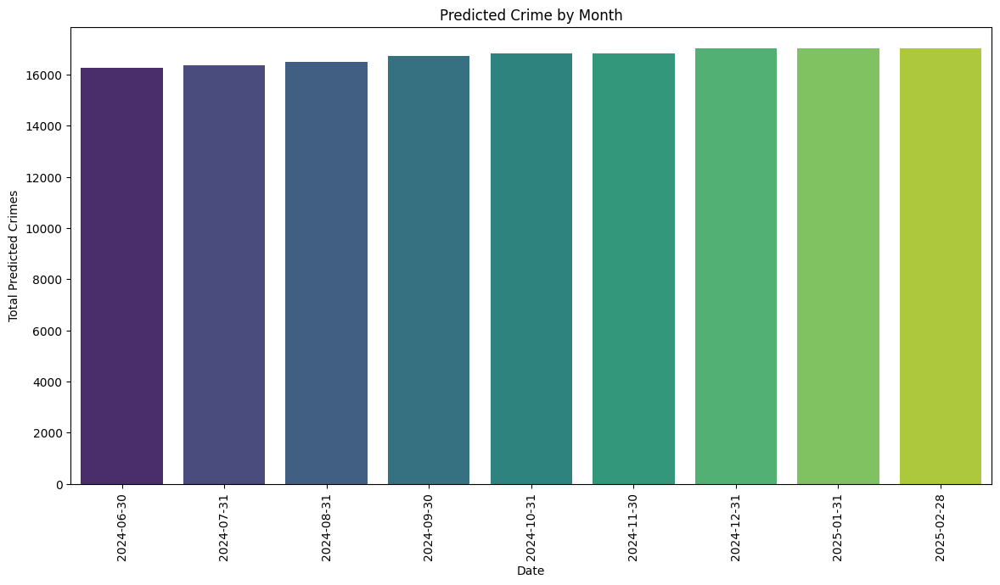

In [87]:
# Group the predictions by date and sum the predictions
predictions_by_date = predictions.groupby('Date')['Prediction'].sum().reset_index()

# Plot the data
plt.figure(figsize=(14, 7))
sns.barplot(x='Date', y='Prediction', data=predictions_by_date, palette='viridis')
plt.title('Predicted Crime by Month')
plt.xlabel('Date')
plt.ylabel('Total Predicted Crimes')
plt.xticks(rotation=90)
plt.show()

In [88]:
# Prediction by Area and Date

predictions_by_area_and_date = predictions.groupby(['Area', 'Date'])['Prediction'].sum().reset_index()
predictions_by_area_and_date.head()

,Area,Date,Prediction
0,77th Street,2024-06-30,959
1,77th Street,2024-07-31,970
2,77th Street,2024-08-31,1022
3,77th Street,2024-09-30,1044
4,77th Street,2024-10-31,1038


# **Predicted Crimes by Area Over Time**

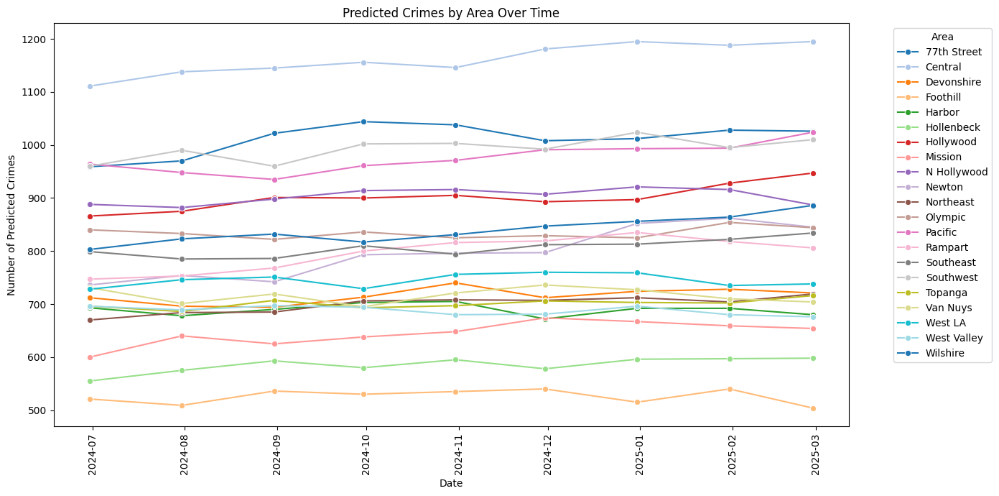

In [89]:
plt.figure(figsize=(14, 7))
sns.lineplot(data=predictions_by_area_and_date, x='Date', y='Prediction', hue='Area', palette='tab20', marker='o')
plt.title('Predicted Crimes by Area Over Time')
plt.xlabel('Date')
plt.ylabel('Number of Predicted Crimes')
plt.xticks(rotation=90)
plt.legend(title='Area', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()